# Instruções da prova

- O único material que poderá ser consultado é este notebook, consultas à outros materiais ou à internet será considerado cola levando à nota zero na prova
- Renomear o notebook para NOME_SOBRENOME_MATRICULA
- Enviar o arquivo .ipynb na tarefa do TEAMS.

# Parte teórica

Classifique as afirmações em Verdadeiro ou Falso, justificando as falsas

1- O formato GIF surgiu como uma evolução do formado PNG, uma das suas vantagens é a possibilidade de representar muito mais cores.

In [ ]:
#Falso, pois o GIF nao surgiu como evoluçaõ do PNG, pois o GIF é mais antigo que o PNG.

2- Métodos de compressão sem perdas são aqueles que permitem a restauração da informação original em sua totalidade, normalmente as perdas são irreversíveis.

In [ ]:
#Falso, as perdas nao são irreversíveis, pois foi afirmado que o método utilizado foi o sem perdas.

3- A compressão com perda deve ser utilizada somente em contextos em que a perda de dados não é importante (exemplos: imagens médicas e documentos de texto).

In [ ]:
#Falso, pois a compressão com perda não deve ser usada em imagens médicas e documentos de texto, pois nesses casos a precisão dos dados é essencial.

4- Quantização consiste em mapear valores de entrada em um conjunto menor de saída (e.g.: arredondamento e truncamento)

In [ ]:
#Verdadeiro

5-  A audição humana escuta ondas entre 20Hz e 20kHz, uma frequência comum é 44,1kHz

In [ ]:
#Verdadeiro

# Parte Prática

## Material de Apoio

### Importações
```
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import sounddevice as sd
from PIL import Image
```matplotlib.pyplot as plt
```

### Histograma
```
def histogram_gray(img):
    (l, c) = img.shape
    # Histograma com 1 linha e 256 colunas, preenchido com 0.
    histogram = np.zeros(256, dtype=np.int32)

    for i in range(l):
        for j in range(c):
            # Normalizar intensidade do pixel 
            intensity = img[i, j]
            # Incrementar de 1 a quantidade de pixels no histograma,
            # utilizando a intensidade como índice.
            histogram[intensity] += 1
            
    return histogram

def show_histogram(img):
    histogram_r = histogram_gray(img[:, :, 0])
    histogram_g = histogram_gray(img[:, :, 1])
    histogram_b = histogram_gray(img[:, :, 2])
    
    plt.figure(figsize=(16, 16))
    plt.subplot(2, 1, 1)
    plt.bar(range(256), histogram_r, color='red')
    plt.bar(range(256), histogram_g, color='green')
    plt.bar(range(256), histogram_b, color='blue')

```

### Manipulação de imagens

```
(l,c,p) = img.shape
plt.imshow(imagem)
```

### Forçando uma imagem de uma página para 3 páginas
```
  imagem_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
  imagem_3p[:,:, 0] = frame_1p
  imagem_3p[:,:, 1] = frame_1p
  imagem_3p[:,:, 2] = frame_1p
```

### Detecção de bordas
```
    imagem_grey = np.average(frame, axis=2).astype(np.float64)
   
    abs_tg_c = np.abs(np.diff(imagem_grey.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(imagem_grey.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    imagem_border = np.zeros(shape=(l, c), dtype=np.uint8)
    imagem_border[abs_tg > threshold] = 255
```

### Manipulação de vídeo
```
video = mpe.VideoFileClip("video.mp4")
frame = video.get_frame(2 / video.fps)
frame = video.get_frame(2)
video.ipython_display(width=480)
video_modificado = video.fl_image(func_modificar)
subclip = video.subclip(0,2)
subclip = video.subclip(3)
parts = mpe.concatenate_videoclips([part1, part])
video.write_videofile('video.mp4')
```
### Manipulação de aúdio
```
fs, data = wavfile.read("nome.extensão")
sd.play(data, fs)
wavfile.write("nome.extensão", fs, parte)
```

### Conversão CM|Y
```
img_cmy = 255 - img_rgb
```

### Reflexão utilizando numpy
```
    img_refl = np.zeros(shape=imagem.shape, dtype=np.uint8)
    img_refl[::1, ::-1] = imagem
```

------------------------------------------------------------------------------------------

In [1]:
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import sounddevice as sd
from PIL import Image

**1 -** Abra o vídeo "boydancing.mp4" e salve-o em uma variável, pegue o **frame do indice 4** e o exiba.

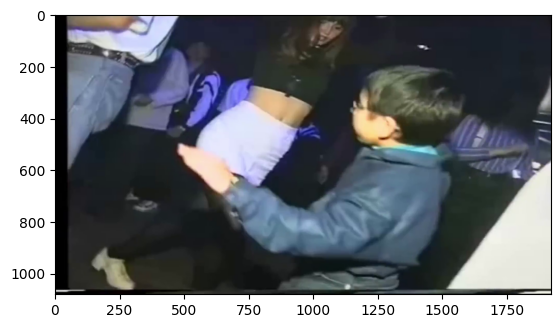

In [2]:
videoprova2 = mpe.VideoFileClip("boydancing.mp4")
frame4 = videoprova2.get_frame(4 / videoprova2.fps)
plt.imshow(frame4)

**2 -** Carregue o áudio **GPdaZL.wav** presente pasta e reproduza-o.

In [3]:

fs, data = wavfile.read("GPdaZL.wav") 
sd.play(data, fs) 

**3 -** Crie uma função que receba um frame e retorne um frame refletido em x e y, aplique essa função no vídeo e observe o resultado. 

In [4]:
def reflectFrameXY(frame):
    rf_img = frame[::-1, ::-1, :]
    return rf_img

video_refletido = videoprova2.fl_image(reflectFrameXY)
video_refletido.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**4 -** Crie uma função que receba um frame e realize a detecção de bordas nele com **treshold de valor 10**, aplique essa função no vídeo e observe o resultado. **Sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [5]:
def deteccao_bordas(frame):
    (l,c,p) = frame.shape
    
    frame_bw = np.average(frame, axis=2).astype(np.float64)
    
    abs_tg_c = np.abs(np.diff(frame_bw.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(frame_bw.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    threshold = 10
    frame_border = np.zeros(shape=(l, c), dtype=np.uint8)
    frame_border[abs_tg > threshold] = 255
    
    frame_3_paginas = np.zeros(shape=(l,c,p),dtype=np.uint8)
    frame_3_paginas[:, :, 0] = frame_border
    frame_3_paginas[:, :, 1] = frame_border
    frame_3_paginas[:, :, 2] = frame_border
    
    return frame_3_paginas

video_border = videoprova2.fl_image(deteccao_bordas)
video_border.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**5 -** Crie uma função que receba um frame e retorne esse frame convertido para o espaço de cor CMY

In [6]:
def convert_cmy(frame):
    return (255-frame)

videoframe = videoprova2.fl_image(convert_cmy)
videoframe.ipython_display(width=480) 

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**6 -** Separe o vídeo original em 3 subclips:
- Segundos 0 ao 2: Aplicar conversão para cmy
- Segundos 2 ao 4: Aplicar reflexão no eixo x e y
- Segundos 4 em diante: Aplicar detecção de borda

**Una esses clips em um único vídeo, exiba o resultado e, por fim, salve com o nome "littleboy".**

In [7]:
parte1 = videoprova2.subclip(0,2).fl_image(convert_cmy)
parte2 = videoprova2.subclip(2,4).fl_image(reflectFrameXY)
parte3 = videoprova2.subclip(4).fl_image(deteccao_bordas)

partes = mpe.concatenate_videoclips([parte1, parte2, parte3])
partes.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**7 -** Salve o vídeo resultante da última etapa com o nome "littleboy.mp4".

In [8]:
partes.write_videofile('littleboy.mp4')

Moviepy - Building video littleboy.mp4.
MoviePy - Writing audio in littleboyTEMP_MPY_wvf_snd.mp3


MoviePy - Done.


Moviepy - Writing video littleboy.mp4



Moviepy - Done !
Moviepy - video ready littleboy.mp4


**8** - Divida o áudio da questão anterior em duas partes. A primeira de 0 até 6 segundos e a segunda de 6 segundos até o final. Reproduza as duas partes e salve a primeira parte como "audio1.wav" .

In [10]:
audio1 = data[fs * 0:fs * 6, :] 
audio2 = data[fs * 6:, :] 

sd.play(audio1, fs)
sd.play(audio2, fs)

wavfile.write('audio1.wav', fs, audio1)

**9** - Reproduza a primeira parte do áudio 50% mais aguda e a segunda parte 50% mais grave.

In [11]:
sd.play(audio1, fs*1.5)
sd.play(audio2, fs*0.5)

# Resultado

In [12]:
from moviepy.editor import VideoFileClip, AudioFileClip

video = VideoFileClip("littleboy.mp4")
audio = AudioFileClip("audio1.wav")

video_with_new_audio = video.set_audio(audio)

video_with_new_audio.ipython_display(width=480) 


Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**10** - Salve o vídeo resultante da última etapa com o nome "boydancingGP.mp4".

In [13]:
partes.write_videofile('boydancingGP.mp4')

Moviepy - Building video boydancingGP.mp4.
MoviePy - Writing audio in boydancingGPTEMP_MPY_wvf_snd.mp3


MoviePy - Done.


Moviepy - Writing video boydancingGP.mp4



Moviepy - Done !
Moviepy - video ready boydancingGP.mp4
